In [0]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import geopandas as gpd
from scipy.spatial import ConvexHull
from shapely.geometry import Point

### Reading in the data and looking at the columns

In [0]:
df = pd.read_csv(
    "/Volumes/data_511/default/crime_data/SPD_Crime_Data__2008-Present_20251028.csv",
    header=0
)

In [0]:
print(df.columns)

df.shape

Index(['Report Number', 'Report DateTime', 'Offense ID', 'Offense Date',
       'NIBRS Group AB', 'NIBRS Crime Against Category',
       'Offense Sub Category', 'Shooting Type Group', 'Block Address',
       'Latitude', 'Longitude', 'Beat', 'Precinct', 'Sector', 'Neighborhood',
       'Reporting Area', 'Offense Category', 'NIBRS Offense Code Description',
       'NIBRS_offense_code'],
      dtype='object')


(1490998, 19)

### Investigating missing data

In [0]:
import numpy as np
import pandas as pd

for item in df.columns:
    df[item] = df[item].replace(
        ['-', 'REDACTED', -1.0],
        np.nan
    )

df['Latitude'] = pd.to_numeric(
    df['Latitude'],
    errors='coerce'
)
df['Longitude'] = pd.to_numeric(
    df['Longitude'],
    errors='coerce'
)

df.loc[
    (df['Latitude'] < 47.0) | (df['Latitude'] > 48.1),
    ['Latitude', 'Longitude']
] = np.nan
df.loc[
    (df['Longitude'] < -123.5) | (df['Longitude'] > -121.0),
    ['Latitude', 'Longitude']
] = np.nan

df_missing_loc = df[df['Latitude'].isna()]
display(df_missing_loc)

Report Number,Report DateTime,Offense ID,Offense Date,NIBRS Group AB,NIBRS Crime Against Category,Offense Sub Category,Shooting Type Group,Block Address,Latitude,Longitude,Beat,Precinct,Sector,Neighborhood,Reporting Area,Offense Category,NIBRS Offense Code Description,NIBRS_offense_code
2015-030183,2015 Jan 27 01:43:00 PM,7681626833,2015 Jan 21 08:00:00 AM,B,ANY,ALL OTHER,null,null,null,null,B1,North,B,null,5065,ALL OTHER,All Other Offenses,90Z
2010-392703,2010 Nov 10 10:40:00 AM,7637078160,2010 Nov 10 10:00:00 AM,A,PROPERTY,LARCENY-THEFT,null,null,null,null,W2,Southwest,W,null,null,PROPERTY CRIME,All Other Larceny,23H
2011-278066,2011 Aug 24 09:39:00 AM,7626145818,2011 Aug 23 09:45:00 PM,A,PROPERTY,LARCENY-THEFT,null,null,null,null,U1,North,U,null,2162,PROPERTY CRIME,Theft From Building,23D
2016-274934,2016 Jul 31 02:24:00 PM,7640048017,2016 Jul 31 02:20:00 PM,B,SOCIETY,NON-VIOLENT FAMILY OFFENSES,null,null,null,null,U2,North,U,null,null,ALL OTHER,"Family Offenses, Nonviolent",90F
2013-235111,2013 Jul 04 04:05:00 PM,7697811116,2013 Jul 03 10:00:00 PM,B,ANY,ALL OTHER,null,null,null,null,D1,West,D,null,2508,ALL OTHER,All Other Offenses,90Z
2009-135285,2009 Apr 21 07:01:00 PM,7667810181,2009 Apr 21 09:00:00 AM,A,PROPERTY,BURGLARY,null,null,null,null,C1,East,C,null,3582,PROPERTY CRIME,Burglary/Breaking & Entering,220
2011-309327,2011 Sep 19 11:58:00 AM,7680402911,2011 Sep 19 11:58:00 AM,B,ANY,ALL OTHER,null,null,null,null,R2,South,R,null,null,ALL OTHER,All Other Offenses,90Z
2024-013251,2024 Jan 15 07:29:17 AM,53801464906,2024 Jan 15 05:04:00 AM,A,PERSON,ASSAULT OFFENSES,null,null,null,null,S3,South,S,RAINIER VIEW,null,ALL OTHER,Intimidation,13C
2013-000958,2013 Jan 01 07:45:00 PM,7666704951,2013 Jan 01 07:45:00 PM,A,PERSON,ASSAULT OFFENSES,null,null,null,null,U1,North,U,null,null,ALL OTHER,Intimidation,13C
2020-129459,2020 Apr 18 05:18:19 AM,13031368216,2020 Apr 18 01:09:00 AM,A,PERSON,AGGRAVATED ASSAULT,null,null,null,null,B3,North,B,FREMONT,null,VIOLENT CRIME,Aggravated Assault,13A


In [0]:
df['Neighborhood']=df['Neighborhood'].replace('UNKNOWN',np.nan)
df['Neighborhood']=df['Neighborhood'].replace('FK ERROR',np.nan)
df['Neighborhood']=df['Neighborhood'].replace('OOJ',np.nan)

df =df.dropna(subset=['Neighborhood'])

In [0]:
df['NIBRS Crime Against Category']=df['NIBRS Crime Against Category'].replace('ANY',np.nan)
df['NIBRS Crime Against Category']=df['NIBRS Crime Against Category'].replace('NOT_A_CRIME',np.nan)

df = df.dropna(subset=['NIBRS Crime Against Category'])

In [0]:
df['Offense Sub Category']=df['Offense Sub Category'].replace('UNKNOWN',np.nan)
df['Offense Sub Category']=df['Offense Sub Category'].replace('999',np.nan)
df['Offense Sub Category']=df['Offense Sub Category'].replace('',np.nan)

df = df.dropna(subset=['Offense Sub Category'])

We need to drop anything where lat and long are missing

In [0]:
df = df.dropna(subset=['Latitude', 'Longitude'])
df.isna().sum()/len(df)

Report Number                     0.000000
Report DateTime                   0.000000
Offense ID                        0.000000
Offense Date                      0.000000
NIBRS Group AB                    0.000000
NIBRS Crime Against Category      0.000000
Offense Sub Category              0.000000
Shooting Type Group               0.991488
Block Address                     0.000292
Latitude                          0.000000
Longitude                         0.000000
Beat                              0.000007
Precinct                          0.000002
Sector                            0.000002
Neighborhood                      0.000000
Reporting Area                    0.000007
Offense Category                  0.000000
NIBRS Offense Code Description    0.000000
NIBRS_offense_code                0.000000
dtype: float64

In [0]:
df_missing_loc.isnull().sum()/len(df)

Report Number                     0.000000
Report DateTime                   0.000000
Offense ID                        0.000000
Offense Date                      0.000000
NIBRS Group AB                    0.000662
NIBRS Crime Against Category      0.000662
Offense Sub Category              0.000000
Shooting Type Group               0.694107
Block Address                     0.695718
Latitude                          0.697150
Longitude                         0.697150
Beat                              0.018850
Precinct                          0.017063
Sector                            0.018836
Neighborhood                      0.495165
Reporting Area                    0.402372
Offense Category                  0.000000
NIBRS Offense Code Description    0.000662
NIBRS_offense_code                0.000662
dtype: float64

In [0]:
print(df.columns)

df.shape

Index(['Report Number', 'Report DateTime', 'Offense ID', 'Offense Date',
       'NIBRS Group AB', 'NIBRS Crime Against Category',
       'Offense Sub Category', 'Shooting Type Group', 'Block Address',
       'Latitude', 'Longitude', 'Beat', 'Precinct', 'Sector', 'Neighborhood',
       'Reporting Area', 'Offense Category', 'NIBRS Offense Code Description',
       'NIBRS_offense_code'],
      dtype='object')


(557345, 19)

In [0]:
df['Sector']=df['Sector'].replace('None',np.nan)
df['Sector']=df['Sector'].replace('99',np.nan)

df = df.dropna(subset=['Sector'])

In [0]:
df['Sector'].unique()

array(['C', 'W', 'J', 'L', 'U', 'N', 'Q', 'E', 'B', 'K', 'O', 'M', 'D',
       'F', 'R', 'G', 'S'], dtype=object)

In [0]:
df['Shooting Type Group'] = df['Shooting Type Group'].fillna("No Shooting")

In [0]:
df['Shooting Type Group'].unique()

array(['No Shooting', 'Shots Fired (Eyewitness/Casings/Property Damage)',
       'Shooting (Non-Fatal Injury)', 'Shooting (Fatal Injury)'],
      dtype=object)

In [0]:
df = df.dropna(subset=['Block Address'])

In [0]:
df = df.dropna(subset=['Reporting Area'])

In [0]:
df = df.dropna(subset=['Beat'])

In [0]:
df.isna().sum()

Report Number                     0
Report DateTime                   0
Offense ID                        0
Offense Date                      0
NIBRS Group AB                    0
NIBRS Crime Against Category      0
Offense Sub Category              0
Shooting Type Group               0
Block Address                     0
Latitude                          0
Longitude                         0
Beat                              0
Precinct                          0
Sector                            0
Neighborhood                      0
Reporting Area                    0
Offense Category                  0
NIBRS Offense Code Description    0
NIBRS_offense_code                0
dtype: int64

In [0]:
df['Offense Sub Category'].unique()

array(['LARCENY-THEFT', 'AGGRAVATED ASSAULT', 'ASSAULT OFFENSES',
       'NARCOTIC VIOLATIONS (INCLUDES DRUG EQUIP.)',
       'LIQUOR LAW VIOLATIONS & DRUNKENNESS', 'BURGLARY',
       'MOTOR VEHICLE THEFT', 'TRESPASS', 'ARSON',
       'PROPERTY OFFENSES (INCLUDES STOLEN, DESTRUCTION)',
       'EXTORTION/FRAUD/FORGERY/BRIBERY (INCLUDES BAD CHECKS)',
       'WEAPON LAW VIOLATION', 'DUI',
       'DISORDERLY CONDUCT & VAGRANCY VIOLATIONS', 'ROBBERY',
       'SEX OFFENSES', 'PORNOGRAPHY', 'VIOLATION OF NO CONTACT ORDER',
       'KIDNAPPING/ABDUCTION', 'GAMBLING OFFENSES', 'ANIMAL CRUELTY',
       'PROSTITUTION OFFENSES', 'NON-VIOLENT FAMILY OFFENSES', 'HOMICIDE',
       'RAPE', 'HUMAN TRAFFICKING'], dtype=object)

### Getting the data into the most appropriate types

In [0]:
df['Latitude']=pd.to_numeric(df['Latitude'],errors='coerce')
df['Longitude']=pd.to_numeric(df['Longitude'],errors='coerce')

In [0]:
# Split 'Offense Date' into year, month, day, time columns
df['Offense Year'] = pd.to_datetime(df['Offense Date'], errors='coerce').dt.year
df['Offense Month'] = pd.to_datetime(df['Offense Date'], errors='coerce').dt.month
df['Offense Day'] = pd.to_datetime(df['Offense Date'], errors='coerce').dt.day
df['Offense Time'] = pd.to_datetime(df['Offense Date'], errors='coerce').dt.time

In [0]:
violent = [
    'ASSAULT OFFENSES', 'AGGRAVATED ASSAULT', 'ROBBERY',
    'SEX OFFENSES', 'RAPE', 'KIDNAPPING/ABDUCTION',
    'HOMICIDE', 'HUMAN TRAFFICKING','JUSTIFIABLE HOMICIDE'
]

property_ = [
    'LARCENY-THEFT', 'BURGLARY', 'MOTOR VEHICLE THEFT',
    'PROPERTY OFFENSES (INCLUDES STOLEN, DESTRUCTION)',
    'EXTORTION/FRAUD/FORGERY/BRIBERY (INCLUDES BAD CHECKS)',
    'ARSON'
]

disorder = [
    'TRESPASS', 'DISORDERLY CONDUCT & VAGRANCY VIOLATIONS',
    'PROSTITUTION OFFENSES', 'LIQUOR LAW VIOLATIONS & DRUNKENNESS',
    'WEAPON LAW VIOLATION'
]

drug = [
    'NARCOTIC VIOLATIONS (INCLUDES DRUG EQUIP.)'
]

dui = ['DUI']

other = [
    'ANIMAL CRUELTY', 'PORNOGRAPHY', 'NON-VIOLENT FAMILY OFFENSES',
    'GAMBLING OFFENSES', 'VIOLATION OF NO CONTACT ORDER',
    'ALL OTHER', '999', 'UNKNOWN', 'RUNAWAY'
]

mapping = {}

for x in violent:
    mapping[x] = 'Violent Crime'

for x in property_:
    mapping[x] = 'Property Crime'

for x in disorder:
    mapping[x] = 'Disorder'

for x in drug:
    mapping[x] = 'Drug/Narcotic'

for x in dui:
    mapping[x] = 'DUI/Traffic'

for x in other:
    mapping[x] = 'Other'

df['crime_group'] = df['Offense Sub Category'].map(mapping)

In [0]:
df.columns

Index(['Report Number', 'Report DateTime', 'Offense ID', 'Offense Date',
       'NIBRS Group AB', 'NIBRS Crime Against Category',
       'Offense Sub Category', 'Shooting Type Group', 'Block Address',
       'Latitude', 'Longitude', 'Beat', 'Precinct', 'Sector', 'Neighborhood',
       'Reporting Area', 'Offense Category', 'NIBRS Offense Code Description',
       'NIBRS_offense_code', 'Offense Year', 'Offense Month', 'Offense Day',
       'Offense Time', 'crime_group'],
      dtype='object')

In [0]:
display(df['Offense Sub Category'].dropna().unique())

array(['LARCENY-THEFT', 'AGGRAVATED ASSAULT', 'ASSAULT OFFENSES',
       'NARCOTIC VIOLATIONS (INCLUDES DRUG EQUIP.)',
       'LIQUOR LAW VIOLATIONS & DRUNKENNESS', 'BURGLARY',
       'MOTOR VEHICLE THEFT', 'TRESPASS', 'ARSON',
       'PROPERTY OFFENSES (INCLUDES STOLEN, DESTRUCTION)',
       'EXTORTION/FRAUD/FORGERY/BRIBERY (INCLUDES BAD CHECKS)',
       'WEAPON LAW VIOLATION', 'DUI',
       'DISORDERLY CONDUCT & VAGRANCY VIOLATIONS', 'ROBBERY',
       'SEX OFFENSES', 'PORNOGRAPHY', 'VIOLATION OF NO CONTACT ORDER',
       'KIDNAPPING/ABDUCTION', 'GAMBLING OFFENSES', 'ANIMAL CRUELTY',
       'PROSTITUTION OFFENSES', 'NON-VIOLENT FAMILY OFFENSES', 'HOMICIDE',
       'RAPE', 'HUMAN TRAFFICKING'], dtype=object)

In [0]:
display(df['Offense Sub Category'].value_counts())

Offense Sub Category
LARCENY-THEFT                                            220851
BURGLARY                                                  74947
PROPERTY OFFENSES (INCLUDES STOLEN, DESTRUCTION)          61502
MOTOR VEHICLE THEFT                                       50700
ASSAULT OFFENSES                                          42390
EXTORTION/FRAUD/FORGERY/BRIBERY (INCLUDES BAD CHECKS)     41702
AGGRAVATED ASSAULT                                        19278
ROBBERY                                                   13319
DUI                                                       10215
NARCOTIC VIOLATIONS (INCLUDES DRUG EQUIP.)                10047
WEAPON LAW VIOLATION                                       5925
TRESPASS                                                   2256
DISORDERLY CONDUCT & VAGRANCY VIOLATIONS                   1504
ARSON                                                      1363
SEX OFFENSES                                                376
ANIMAL CRUELTY     

In [0]:
df['NIBRS Crime Against Category'].unique()

array(['PROPERTY', 'PERSON', 'SOCIETY'], dtype=object)

### Removing redundant columns

In [0]:
df = df.drop('Report DateTime', axis=1)

In [0]:
df = df.rename(columns={'Offense Date': 'Offense DateTime'})

### Hazard score

In [0]:
hazard_map = {
    # 0
    "GAMBLING OFFENSES": 0,
    "LIQUOR LAW VIOLATIONS & DRUNKENNESS": 0,
    "NARCOTIC VIOLATIONS (INCLUDES DRUG EQUIP.)": 0,
    "PROSTITUTION OFFENSES": 0,
    "PORNOGRAPHY": 0,
    "EXTORTION/FRAUD/FORGERY/BRIBERY (INCLUDES BAD CHECKS)": 0,
    "DUI": 0,
    "ALL OTHER": 0,
    "NON-VIOLENT FAMILY OFFENSES": 0,

    # 1
    "DISORDERLY CONDUCT & VAGRANCY VIOLATIONS": 1,
    "TRESPASS": 1,
    "ANIMAL CRUELTY": 1,

    # 2
    "PROPERTY OFFENSES (INCLUDES STOLEN, DESTRUCTION)": 2,
    "LARCENY-THEFT": 2,
    "MOTOR VEHICLE THEFT": 2,
    "VIOLATION OF NO CONTACT ORDER": 3,

    # 3
    "BURGLARY": 3,
    "ARSON": 3,
    "ROBBERY": 3,
    "WEAPON LAW VIOLATION": 3,

    # 4
    "ASSAULT OFFENSES": 4,
    "AGGRAVATED ASSAULT": 4,
    "SEX OFFENSES": 4,

    # 5
    "KIDNAPPING/ABDUCTION": 5,
    "RAPE": 5,
    "HUMAN TRAFFICKING": 5,
    "HOMICIDE": 5
}

df['Hazardness'] = df['Offense Sub Category'].map(hazard_map)

In [0]:
df.columns

Index(['Report Number', 'Offense ID', 'Offense DateTime', 'NIBRS Group AB',
       'NIBRS Crime Against Category', 'Offense Sub Category',
       'Shooting Type Group', 'Block Address', 'Latitude', 'Longitude', 'Beat',
       'Precinct', 'Sector', 'Neighborhood', 'Reporting Area',
       'Offense Category', 'NIBRS Offense Code Description',
       'NIBRS_offense_code', 'Offense Year', 'Offense Month', 'Offense Day',
       'Offense Time', 'crime_group', 'Hazardness'],
      dtype='object')

In [0]:
display(df['Hazardness'].value_counts())

Hazardness
2    333053
3     95687
0     62156
4     62044
1      3997
5       237
Name: count, dtype: int64

In [0]:
display(df['Hazardness'].isna().any())

np.False_

In [0]:
display(df[df['Hazardness'].isna()]['Offense Sub Category'].dropna().unique())

array([], dtype=object)

In [0]:
df.head()

,Report Number,Offense ID,Offense DateTime,NIBRS Group AB,NIBRS Crime Against Category,Offense Sub Category,Shooting Type Group,Block Address,Latitude,Longitude,Beat,Precinct,Sector,Neighborhood,Reporting Area,Offense Category,NIBRS Offense Code Description,NIBRS_offense_code,Offense Year,Offense Month,Offense Day,Offense Time,crime_group,Hazardness
1,2017-090917,7694314539,2017 Mar 14 08:00:00 AM,A,PROPERTY,LARCENY-THEFT,No Shooting,18XX BLOCK OF 25TH AVE,47.618270,-122.299874,C3,East,C,CENTRAL AREA/SQUIRE PARK,8211,PROPERTY CRIME,All Other Larceny,23H,2017,3,14,08:00:00,Property Crime,2
4,2022-007352,31041979799,2022 Jan 09 04:15:00 PM,A,PROPERTY,LARCENY-THEFT,No Shooting,43XX BLOCK OF SW ADMIRAL WAY,47.581188,-122.387203,W1,Southwest,W,NORTH ADMIRAL,2390,PROPERTY CRIME,Shoplifting,23C,2022,1,9,16:15:00,Property Crime,2
8,2024-183922,57402908681,2024 Jul 04 03:45:00 PM,A,PROPERTY,LARCENY-THEFT,No Shooting,57XX BLOCK OF W GREEN LAKE WAY N,47.671529,-122.343687,J3,North,J,ROOSEVELT/RAVENNA,7143,PROPERTY CRIME,Theft of Motor Vehicle Parts or Accessories,23G,2024,7,4,15:45:00,Property Crime,2
9,2024-308555,60314128977,2024 Oct 31 01:20:00 AM,A,PERSON,AGGRAVATED ASSAULT,No Shooting,125XX BLOCK OF LAKE CITY WAY NE,47.720185,-122.294697,L3,North,L,LAKECITY,13044,VIOLENT CRIME,Aggravated Assault,13A,2024,10,31,01:20:00,Violent Crime,4
11,2019-197581,8277175027,2019 May 31 09:30:00 PM,A,PROPERTY,LARCENY-THEFT,No Shooting,74XX BLOCK OF SAND POINT WAY NE,47.682525,-122.263683,U3,North,U,SANDPOINT,4644,PROPERTY CRIME,All Other Larceny,23H,2019,5,31,21:30:00,Property Crime,2


### Actual neighborhood stuff

Index(['id', 'city', 'county', 'nhood', 'nested', 'area', 'name', 'geometry'], dtype='object')
                                 id  ...                                           geometry
0     Seattle:Ballard:Loyal Heights  ...  POLYGON ((-122.37633 47.67594, -122.37669 47.6...
1             Seattle:Ballard:Adams  ...  POLYGON ((-122.37633 47.67594, -122.37621 47.6...
2  Seattle:Ballard:Whittier Heights  ...  POLYGON ((-122.37633 47.67594, -122.37657 47.6...
3     Seattle:Ballard:West Woodland  ...  POLYGON ((-122.37633 47.67594, -122.3761 47.67...
4       Seattle:Ballard:Sunset Hill  ...  POLYGON ((-122.40211 47.69766, -122.40199 47.6...

[5 rows x 8 columns]
Capitol Hill <class 'NoneType'> None


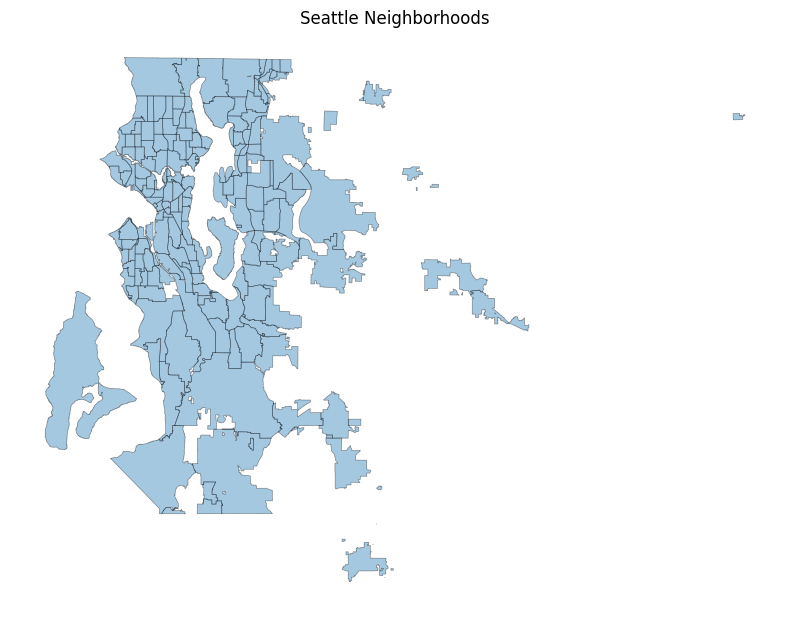

In [0]:
import geopandas as gpd
import matplotlib.pyplot as plt

# 1. Load Seattle neighborhood GeoJSON
url = "https://raw.githubusercontent.com/seattleio/seattle-boundaries-data/master/data/neighborhoods.geojson"

gdf = gpd.read_file(url)

# Inspect columns to find the neighborhood name field
print(gdf.columns)
print(gdf.head())

# 2. Build a dict of Shapely geometries keyed by neighborhood name
NAME_COL = "name"
neighborhood_polygons = {
    row[NAME_COL]: row.geometry
    for _, row in gdf.iterrows()
}

# Test single neighborhood
some_neighborhood = "Capitol Hill"
geom = neighborhood_polygons.get(some_neighborhood)
print(some_neighborhood, type(geom), geom)

# 3. Plot a map of all neighborhoods
fig, ax = plt.subplots(figsize=(8, 10))
gdf.plot(ax=ax, edgecolor="black", linewidth=0.5, alpha=0.4)
ax.set_title("Seattle Neighborhoods")
ax.set_axis_off()
plt.tight_layout()
plt.show()

In [0]:
from shapely.geometry import Point

hoods_changed = 0

for idx, row in df.iterrows():
    pt = Point(row['Longitude'], row['Latitude'])
    for hood, poly in neighborhood_polygons.items():
        if poly.contains(pt):
            df.at[idx, 'Neighborhood'] = hood
            hoods_changed += 1

print(f"Changed {hoods_changed} rows")

com.databricks.backend.common.rpc.CommandCancelledException
	at com.databricks.spark.chauffeur.SequenceExecutionState.$anonfun$cancel$5(SequenceExecutionState.scala:139)
	at scala.Option.getOrElse(Option.scala:201)
	at com.databricks.spark.chauffeur.SequenceExecutionState.$anonfun$cancel$3(SequenceExecutionState.scala:139)
	at com.databricks.spark.chauffeur.SequenceExecutionState.$anonfun$cancel$3$adapted(SequenceExecutionState.scala:136)
	at scala.collection.immutable.Range.foreach(Range.scala:192)
	at com.databricks.spark.chauffeur.SequenceExecutionState.cancel(SequenceExecutionState.scala:136)
	at com.databricks.spark.chauffeur.ExecContextState.cancelRunningSequence(ExecContextState.scala:721)
	at com.databricks.spark.chauffeur.ExecContextState.$anonfun$cancel$1(ExecContextState.scala:441)
	at scala.Option.getOrElse(Option.scala:201)
	at com.databricks.spark.chauffeur.ExecContextState.cancel(ExecContextState.scala:441)
	at com.databricks.spark.chauffeur.ExecutionContextManagerV1.can

In [0]:
from pyspark.sql.functions import to_timestamp

# Convert 'Offense Time' to string for Spark compatibility
if 'Offense Time' in df.columns:
    df['Offense Time'] = df['Offense Time'].astype(str)
if 'Offense Datetime' in df.columns:
    df['Offense Datetime'] = df['Offense Datetime'].astype(str)
spark_df = spark.createDataFrame(df)

# Cast 'Offense Time' to TimestampType in Spark
if 'Offense Time' in spark_df.columns:
    spark_df = spark_df.withColumn('Offense Time', to_timestamp('Offense Time', 'HH:mm:ss'))
if 'Offense Datetime' in spark_df.columns:
    spark_df = spark_df.withColumn('Offense Datetime', to_timestamp('Offense Datetime', 'yyyy-MM-dd HH:mm:ss'))

com.databricks.backend.common.rpc.CommandSkippedException
	at com.databricks.spark.chauffeur.SequenceExecutionState.$anonfun$cancel$3(SequenceExecutionState.scala:141)
	at com.databricks.spark.chauffeur.SequenceExecutionState.$anonfun$cancel$3$adapted(SequenceExecutionState.scala:136)
	at scala.collection.immutable.Range.foreach(Range.scala:192)
	at com.databricks.spark.chauffeur.SequenceExecutionState.cancel(SequenceExecutionState.scala:136)
	at com.databricks.spark.chauffeur.ExecContextState.cancelRunningSequence(ExecContextState.scala:721)
	at com.databricks.spark.chauffeur.ExecContextState.$anonfun$cancel$1(ExecContextState.scala:441)
	at scala.Option.getOrElse(Option.scala:201)
	at com.databricks.spark.chauffeur.ExecContextState.cancel(ExecContextState.scala:441)
	at com.databricks.spark.chauffeur.ExecutionContextManagerV1.cancelExecution(ExecutionContextManagerV1.scala:470)
	at com.databricks.spark.chauffeur.ChauffeurState.$anonfun$process$1(ChauffeurState.scala:768)
	at com.data

In [0]:
spark_df

com.databricks.backend.common.rpc.CommandSkippedException
	at com.databricks.spark.chauffeur.SequenceExecutionState.$anonfun$cancel$3(SequenceExecutionState.scala:141)
	at com.databricks.spark.chauffeur.SequenceExecutionState.$anonfun$cancel$3$adapted(SequenceExecutionState.scala:136)
	at scala.collection.immutable.Range.foreach(Range.scala:192)
	at com.databricks.spark.chauffeur.SequenceExecutionState.cancel(SequenceExecutionState.scala:136)
	at com.databricks.spark.chauffeur.ExecContextState.cancelRunningSequence(ExecContextState.scala:721)
	at com.databricks.spark.chauffeur.ExecContextState.$anonfun$cancel$1(ExecContextState.scala:441)
	at scala.Option.getOrElse(Option.scala:201)
	at com.databricks.spark.chauffeur.ExecContextState.cancel(ExecContextState.scala:441)
	at com.databricks.spark.chauffeur.ExecutionContextManagerV1.cancelExecution(ExecutionContextManagerV1.scala:470)
	at com.databricks.spark.chauffeur.ChauffeurState.$anonfun$process$1(ChauffeurState.scala:768)
	at com.data

In [0]:
spark_df.write.format("delta") \
    .option("delta.columnMapping.mode", "name") \
    .option("overwriteSchema", "true") \
    .mode("overwrite") \
    .saveAsTable("data_511.default.crime_gold_data")

com.databricks.backend.common.rpc.CommandSkippedException
	at com.databricks.spark.chauffeur.SequenceExecutionState.$anonfun$cancel$3(SequenceExecutionState.scala:141)
	at com.databricks.spark.chauffeur.SequenceExecutionState.$anonfun$cancel$3$adapted(SequenceExecutionState.scala:136)
	at scala.collection.immutable.Range.foreach(Range.scala:192)
	at com.databricks.spark.chauffeur.SequenceExecutionState.cancel(SequenceExecutionState.scala:136)
	at com.databricks.spark.chauffeur.ExecContextState.cancelRunningSequence(ExecContextState.scala:721)
	at com.databricks.spark.chauffeur.ExecContextState.$anonfun$cancel$1(ExecContextState.scala:441)
	at scala.Option.getOrElse(Option.scala:201)
	at com.databricks.spark.chauffeur.ExecContextState.cancel(ExecContextState.scala:441)
	at com.databricks.spark.chauffeur.ExecutionContextManagerV1.cancelExecution(ExecutionContextManagerV1.scala:470)
	at com.databricks.spark.chauffeur.ChauffeurState.$anonfun$process$1(ChauffeurState.scala:768)
	at com.data

In [0]:
spark_df = spark.read.table("data_511.default.crime_gold_data")
df = spark_df.toPandas()

com.databricks.backend.common.rpc.CommandSkippedException
	at com.databricks.spark.chauffeur.SequenceExecutionState.$anonfun$cancel$3(SequenceExecutionState.scala:141)
	at com.databricks.spark.chauffeur.SequenceExecutionState.$anonfun$cancel$3$adapted(SequenceExecutionState.scala:136)
	at scala.collection.immutable.Range.foreach(Range.scala:192)
	at com.databricks.spark.chauffeur.SequenceExecutionState.cancel(SequenceExecutionState.scala:136)
	at com.databricks.spark.chauffeur.ExecContextState.cancelRunningSequence(ExecContextState.scala:721)
	at com.databricks.spark.chauffeur.ExecContextState.$anonfun$cancel$1(ExecContextState.scala:441)
	at scala.Option.getOrElse(Option.scala:201)
	at com.databricks.spark.chauffeur.ExecContextState.cancel(ExecContextState.scala:441)
	at com.databricks.spark.chauffeur.ExecutionContextManagerV1.cancelExecution(ExecutionContextManagerV1.scala:470)
	at com.databricks.spark.chauffeur.ChauffeurState.$anonfun$process$1(ChauffeurState.scala:768)
	at com.data

In [0]:
df

com.databricks.backend.common.rpc.CommandSkippedException
	at com.databricks.spark.chauffeur.SequenceExecutionState.$anonfun$cancel$3(SequenceExecutionState.scala:141)
	at com.databricks.spark.chauffeur.SequenceExecutionState.$anonfun$cancel$3$adapted(SequenceExecutionState.scala:136)
	at scala.collection.immutable.Range.foreach(Range.scala:192)
	at com.databricks.spark.chauffeur.SequenceExecutionState.cancel(SequenceExecutionState.scala:136)
	at com.databricks.spark.chauffeur.ExecContextState.cancelRunningSequence(ExecContextState.scala:721)
	at com.databricks.spark.chauffeur.ExecContextState.$anonfun$cancel$1(ExecContextState.scala:441)
	at scala.Option.getOrElse(Option.scala:201)
	at com.databricks.spark.chauffeur.ExecContextState.cancel(ExecContextState.scala:441)
	at com.databricks.spark.chauffeur.ExecutionContextManagerV1.cancelExecution(ExecutionContextManagerV1.scala:470)
	at com.databricks.spark.chauffeur.ChauffeurState.$anonfun$process$1(ChauffeurState.scala:768)
	at com.data

In [0]:
from shapely.ops import nearest_points
from shapely.geometry import Point

# Find rows where 'Neighborhood' is all caps
mask = df['Neighborhood'].apply(lambda x: isinstance(x, str) and x.isupper())

def closest_neighborhood(row, polygons):
    print(row['Neighborhood'])
    pt = Point(row['Longitude'], row['Latitude'])
    min_dist = float('inf')
    closest_hood = None
    for hood, poly in polygons.items():
        dist = pt.distance(poly)
        if dist < min_dist:
            min_dist = dist
            closest_hood = hood
    return closest_hood

df.loc[mask, 'Closest Neighborhood'] = df[mask].apply(
    lambda row: closest_neighborhood(row, neighborhood_polygons), axis=1
)

display(df.loc[mask, ['Neighborhood', 'Closest Neighborhood', 'Longitude', 'Latitude']])

com.databricks.backend.common.rpc.CommandSkippedException
	at com.databricks.spark.chauffeur.SequenceExecutionState.$anonfun$cancel$3(SequenceExecutionState.scala:141)
	at com.databricks.spark.chauffeur.SequenceExecutionState.$anonfun$cancel$3$adapted(SequenceExecutionState.scala:136)
	at scala.collection.immutable.Range.foreach(Range.scala:192)
	at com.databricks.spark.chauffeur.SequenceExecutionState.cancel(SequenceExecutionState.scala:136)
	at com.databricks.spark.chauffeur.ExecContextState.cancelRunningSequence(ExecContextState.scala:721)
	at com.databricks.spark.chauffeur.ExecContextState.$anonfun$cancel$1(ExecContextState.scala:441)
	at scala.Option.getOrElse(Option.scala:201)
	at com.databricks.spark.chauffeur.ExecContextState.cancel(ExecContextState.scala:441)
	at com.databricks.spark.chauffeur.ExecutionContextManagerV1.cancelExecution(ExecutionContextManagerV1.scala:470)
	at com.databricks.spark.chauffeur.ChauffeurState.$anonfun$process$1(ChauffeurState.scala:768)
	at com.data

In [0]:
mask = df['Neighborhood'].apply(lambda x: isinstance(x, str) and x.isupper())
df.loc[mask, 'Neighborhood'] = df.loc[mask, 'Closest Neighborhood']

com.databricks.backend.common.rpc.CommandSkippedException
	at com.databricks.spark.chauffeur.SequenceExecutionState.$anonfun$cancel$3(SequenceExecutionState.scala:141)
	at com.databricks.spark.chauffeur.SequenceExecutionState.$anonfun$cancel$3$adapted(SequenceExecutionState.scala:136)
	at scala.collection.immutable.Range.foreach(Range.scala:192)
	at com.databricks.spark.chauffeur.SequenceExecutionState.cancel(SequenceExecutionState.scala:136)
	at com.databricks.spark.chauffeur.ExecContextState.cancelRunningSequence(ExecContextState.scala:721)
	at com.databricks.spark.chauffeur.ExecContextState.$anonfun$cancel$1(ExecContextState.scala:441)
	at scala.Option.getOrElse(Option.scala:201)
	at com.databricks.spark.chauffeur.ExecContextState.cancel(ExecContextState.scala:441)
	at com.databricks.spark.chauffeur.ExecutionContextManagerV1.cancelExecution(ExecutionContextManagerV1.scala:470)
	at com.databricks.spark.chauffeur.ChauffeurState.$anonfun$process$1(ChauffeurState.scala:768)
	at com.data

In [0]:
df['Neighborhood'].unique()

com.databricks.backend.common.rpc.CommandSkippedException
	at com.databricks.spark.chauffeur.SequenceExecutionState.$anonfun$cancel$3(SequenceExecutionState.scala:141)
	at com.databricks.spark.chauffeur.SequenceExecutionState.$anonfun$cancel$3$adapted(SequenceExecutionState.scala:136)
	at scala.collection.immutable.Range.foreach(Range.scala:192)
	at com.databricks.spark.chauffeur.SequenceExecutionState.cancel(SequenceExecutionState.scala:136)
	at com.databricks.spark.chauffeur.ExecContextState.cancelRunningSequence(ExecContextState.scala:721)
	at com.databricks.spark.chauffeur.ExecContextState.$anonfun$cancel$1(ExecContextState.scala:441)
	at scala.Option.getOrElse(Option.scala:201)
	at com.databricks.spark.chauffeur.ExecContextState.cancel(ExecContextState.scala:441)
	at com.databricks.spark.chauffeur.ExecutionContextManagerV1.cancelExecution(ExecutionContextManagerV1.scala:470)
	at com.databricks.spark.chauffeur.ChauffeurState.$anonfun$process$1(ChauffeurState.scala:768)
	at com.data

In [0]:
df.drop(columns=['Closest Neighborhood'], inplace=True)

com.databricks.backend.common.rpc.CommandSkippedException
	at com.databricks.spark.chauffeur.SequenceExecutionState.$anonfun$cancel$3(SequenceExecutionState.scala:141)
	at com.databricks.spark.chauffeur.SequenceExecutionState.$anonfun$cancel$3$adapted(SequenceExecutionState.scala:136)
	at scala.collection.immutable.Range.foreach(Range.scala:192)
	at com.databricks.spark.chauffeur.SequenceExecutionState.cancel(SequenceExecutionState.scala:136)
	at com.databricks.spark.chauffeur.ExecContextState.cancelRunningSequence(ExecContextState.scala:721)
	at com.databricks.spark.chauffeur.ExecContextState.$anonfun$cancel$1(ExecContextState.scala:441)
	at scala.Option.getOrElse(Option.scala:201)
	at com.databricks.spark.chauffeur.ExecContextState.cancel(ExecContextState.scala:441)
	at com.databricks.spark.chauffeur.ExecutionContextManagerV1.cancelExecution(ExecutionContextManagerV1.scala:470)
	at com.databricks.spark.chauffeur.ChauffeurState.$anonfun$process$1(ChauffeurState.scala:768)
	at com.data

In [0]:
df['Offense Time'] = df['Offense Time'].astype(str).str[11:]

com.databricks.backend.common.rpc.CommandSkippedException
	at com.databricks.spark.chauffeur.SequenceExecutionState.$anonfun$cancel$3(SequenceExecutionState.scala:141)
	at com.databricks.spark.chauffeur.SequenceExecutionState.$anonfun$cancel$3$adapted(SequenceExecutionState.scala:136)
	at scala.collection.immutable.Range.foreach(Range.scala:192)
	at com.databricks.spark.chauffeur.SequenceExecutionState.cancel(SequenceExecutionState.scala:136)
	at com.databricks.spark.chauffeur.ExecContextState.cancelRunningSequence(ExecContextState.scala:721)
	at com.databricks.spark.chauffeur.ExecContextState.$anonfun$cancel$1(ExecContextState.scala:441)
	at scala.Option.getOrElse(Option.scala:201)
	at com.databricks.spark.chauffeur.ExecContextState.cancel(ExecContextState.scala:441)
	at com.databricks.spark.chauffeur.ExecutionContextManagerV1.cancelExecution(ExecutionContextManagerV1.scala:470)
	at com.databricks.spark.chauffeur.ChauffeurState.$anonfun$process$1(ChauffeurState.scala:768)
	at com.data

In [0]:
df['Offense Year'] = df['Offense Year'].astype(int)
df['Offense Month'] = df['Offense Month'].astype(int)
df['Offense Day'] = df['Offense Day'].astype(int)

com.databricks.backend.common.rpc.CommandSkippedException
	at com.databricks.spark.chauffeur.SequenceExecutionState.$anonfun$cancel$3(SequenceExecutionState.scala:141)
	at com.databricks.spark.chauffeur.SequenceExecutionState.$anonfun$cancel$3$adapted(SequenceExecutionState.scala:136)
	at scala.collection.immutable.Range.foreach(Range.scala:192)
	at com.databricks.spark.chauffeur.SequenceExecutionState.cancel(SequenceExecutionState.scala:136)
	at com.databricks.spark.chauffeur.ExecContextState.cancelRunningSequence(ExecContextState.scala:721)
	at com.databricks.spark.chauffeur.ExecContextState.$anonfun$cancel$1(ExecContextState.scala:441)
	at scala.Option.getOrElse(Option.scala:201)
	at com.databricks.spark.chauffeur.ExecContextState.cancel(ExecContextState.scala:441)
	at com.databricks.spark.chauffeur.ExecutionContextManagerV1.cancelExecution(ExecutionContextManagerV1.scala:470)
	at com.databricks.spark.chauffeur.ChauffeurState.$anonfun$process$1(ChauffeurState.scala:768)
	at com.data

In [0]:
df['Offense Datetime'] = pd.to_datetime(df['Offense Year'].astype(str) + '-' +
    df['Offense Month'].astype(str).str.zfill(2) + '-' +
    df['Offense Day'].astype(str).str.zfill(2) + ' ' +
    df['Offense Time'])

com.databricks.backend.common.rpc.CommandSkippedException
	at com.databricks.spark.chauffeur.SequenceExecutionState.$anonfun$cancel$3(SequenceExecutionState.scala:141)
	at com.databricks.spark.chauffeur.SequenceExecutionState.$anonfun$cancel$3$adapted(SequenceExecutionState.scala:136)
	at scala.collection.immutable.Range.foreach(Range.scala:192)
	at com.databricks.spark.chauffeur.SequenceExecutionState.cancel(SequenceExecutionState.scala:136)
	at com.databricks.spark.chauffeur.ExecContextState.cancelRunningSequence(ExecContextState.scala:721)
	at com.databricks.spark.chauffeur.ExecContextState.$anonfun$cancel$1(ExecContextState.scala:441)
	at scala.Option.getOrElse(Option.scala:201)
	at com.databricks.spark.chauffeur.ExecContextState.cancel(ExecContextState.scala:441)
	at com.databricks.spark.chauffeur.ExecutionContextManagerV1.cancelExecution(ExecutionContextManagerV1.scala:470)
	at com.databricks.spark.chauffeur.ChauffeurState.$anonfun$process$1(ChauffeurState.scala:768)
	at com.data

In [0]:
df

com.databricks.backend.common.rpc.CommandSkippedException
	at com.databricks.spark.chauffeur.SequenceExecutionState.$anonfun$cancel$3(SequenceExecutionState.scala:141)
	at com.databricks.spark.chauffeur.SequenceExecutionState.$anonfun$cancel$3$adapted(SequenceExecutionState.scala:136)
	at scala.collection.immutable.Range.foreach(Range.scala:192)
	at com.databricks.spark.chauffeur.SequenceExecutionState.cancel(SequenceExecutionState.scala:136)
	at com.databricks.spark.chauffeur.ExecContextState.cancelRunningSequence(ExecContextState.scala:721)
	at com.databricks.spark.chauffeur.ExecContextState.$anonfun$cancel$1(ExecContextState.scala:441)
	at scala.Option.getOrElse(Option.scala:201)
	at com.databricks.spark.chauffeur.ExecContextState.cancel(ExecContextState.scala:441)
	at com.databricks.spark.chauffeur.ExecutionContextManagerV1.cancelExecution(ExecutionContextManagerV1.scala:470)
	at com.databricks.spark.chauffeur.ChauffeurState.$anonfun$process$1(ChauffeurState.scala:768)
	at com.data

In [0]:
import pandas as pd

final_cleaned_df = pd.read_csv(
    "/Volumes/data_511/default/crime_data/crime_data_cleaned.csv",
    header=0
)

com.databricks.backend.common.rpc.CommandSkippedException
	at com.databricks.spark.chauffeur.SequenceExecutionState.$anonfun$cancel$3(SequenceExecutionState.scala:141)
	at com.databricks.spark.chauffeur.SequenceExecutionState.$anonfun$cancel$3$adapted(SequenceExecutionState.scala:136)
	at scala.collection.immutable.Range.foreach(Range.scala:192)
	at com.databricks.spark.chauffeur.SequenceExecutionState.cancel(SequenceExecutionState.scala:136)
	at com.databricks.spark.chauffeur.ExecContextState.cancelRunningSequence(ExecContextState.scala:721)
	at com.databricks.spark.chauffeur.ExecContextState.$anonfun$cancel$1(ExecContextState.scala:441)
	at scala.Option.getOrElse(Option.scala:201)
	at com.databricks.spark.chauffeur.ExecContextState.cancel(ExecContextState.scala:441)
	at com.databricks.spark.chauffeur.ExecutionContextManagerV1.cancelExecution(ExecutionContextManagerV1.scala:470)
	at com.databricks.spark.chauffeur.ChauffeurState.$anonfun$process$1(ChauffeurState.scala:768)
	at com.data

In [0]:
spark_df = spark.read.table("data_511.default.crime_gold_data")

In [0]:
from pyspark.sql.functions import col

spark_df = spark_df.filter(col("NIBRS Crime Against Category").isNotNull())

In [0]:
pandas_df = spark_df.toPandas()

In [0]:
pandas_df['Offense Time'] = pandas_df['Offense Time'].astype(str).str[11:]

In [0]:
pandas_df['Offense Year'] = pandas_df['Offense Year'].astype(int)
pandas_df['Offense Month'] = pandas_df['Offense Month'].astype(int)
pandas_df['Offense Day'] = pandas_df['Offense Day'].astype(int)

In [0]:
pandas_df['Offense Datetime'] = pd.to_datetime(pandas_df['Offense Year'].astype(str) + '-' +
    pandas_df['Offense Month'].astype(str).str.zfill(2) + '-' +
    pandas_df['Offense Day'].astype(str).str.zfill(2) + ' ' +
    pandas_df['Offense Time'])

In [0]:
display(pandas_df)

Report Number,Offense ID,NIBRS Group AB,NIBRS Crime Against Category,Offense Sub Category,Shooting Type Group,Block Address,Latitude,Longitude,Beat,Precinct,Sector,Neighborhood,Reporting Area,Offense Category,NIBRS Offense Code Description,NIBRS_offense_code,Offense Year,Offense Month,Offense Day,Offense Time,crime_group,Hazardness,Offense Datetime
2017-090917,7694314539,A,PROPERTY,LARCENY-THEFT,No Shooting,18XX BLOCK OF 25TH AVE,47.61827015,-122.2998735,C3,East,C,Mann,8211,PROPERTY CRIME,All Other Larceny,23H,2017,3,14,08:00:00,Property Crime,2,2017-03-14T08:00:00.000Z
2022-007352,31041979799,A,PROPERTY,LARCENY-THEFT,No Shooting,43XX BLOCK OF SW ADMIRAL WAY,47.58118761,-122.387202700505,W1,Southwest,W,North Admiral,2390,PROPERTY CRIME,Shoplifting,23C,2022,1,9,16:15:00,Property Crime,2,2022-01-09T16:15:00.000Z
2024-183922,57402908681,A,PROPERTY,LARCENY-THEFT,No Shooting,57XX BLOCK OF W GREEN LAKE WAY N,47.671529,-122.343687,J3,North,J,Green Lake,7143,PROPERTY CRIME,Theft of Motor Vehicle Parts or Accessories,23G,2024,7,4,15:45:00,Property Crime,2,2024-07-04T15:45:00.000Z
2024-308555,60314128977,A,PERSON,AGGRAVATED ASSAULT,No Shooting,125XX BLOCK OF LAKE CITY WAY NE,47.72018507,-122.294696917842,L3,North,L,Cedar Park,13044,VIOLENT CRIME,Aggravated Assault,13A,2024,10,31,01:20:00,Violent Crime,4,2024-10-31T01:20:00.000Z
2019-197581,8277175027,A,PROPERTY,LARCENY-THEFT,No Shooting,74XX BLOCK OF SAND POINT WAY NE,47.682525,-122.263683,U3,North,U,Sand Point,4644,PROPERTY CRIME,All Other Larceny,23H,2019,5,31,21:30:00,Property Crime,2,2019-05-31T21:30:00.000Z
2021-900578,19532364345,A,PROPERTY,LARCENY-THEFT,No Shooting,96XX BLOCK OF 21ST AVE NW,47.69935158,-122.383033823119,J1,North,J,North Beach - Blue Ridge,49,PROPERTY CRIME,Theft From Motor Vehicle,23F,2021,1,9,09:30:00,Property Crime,2,2021-01-09T09:30:00.000Z
2018-424851,7688650352,A,PERSON,ASSAULT OFFENSES,No Shooting,55XX BLOCK OF 15TH AVE NE,47.66899297,-122.311884294511,U1,North,U,University District,508,ALL OTHER,Intimidation,13C,2018,11,13,00:05:00,Violent Crime,4,2018-11-13T00:05:00.000Z
2023-907161,49319042249,A,PROPERTY,LARCENY-THEFT,No Shooting,13XX BLOCK OF N 125TH ST,47.7195715,-122.34090362506,N2,North,N,Haller Lake,11042,PROPERTY CRIME,Theft of Motor Vehicle Parts or Accessories,23G,2023,4,30,07:00:00,Property Crime,2,2023-04-30T07:00:00.000Z
2024-262270,59255220687,A,PROPERTY,LARCENY-THEFT,No Shooting,3XX BLOCK OF LYNN ST,47.6391107,-122.35171183179554,Q2,West,Q,East Queen Anne,4711,PROPERTY CRIME,Theft From Motor Vehicle,23F,2024,9,15,00:30:00,Property Crime,2,2024-09-15T00:30:00.000Z
2017-172192,7631750603,A,PERSON,ASSAULT OFFENSES,No Shooting,15XX BLOCK OF BELMONT AVE,47.61465973,-122.3244653,E3,East,E,Broadway,662,ALL OTHER,Simple Assault,13B,2017,5,16,13:22:00,Violent Crime,4,2017-05-16T13:22:00.000Z


In [0]:
final_spark_df = spark.createDataFrame(pandas_df)
display(final_spark_df)

Report Number,Offense ID,NIBRS Group AB,NIBRS Crime Against Category,Offense Sub Category,Shooting Type Group,Block Address,Latitude,Longitude,Beat,Precinct,Sector,Neighborhood,Reporting Area,Offense Category,NIBRS Offense Code Description,NIBRS_offense_code,Offense Year,Offense Month,Offense Day,Offense Time,crime_group,Hazardness,Offense Datetime
2017-090917,7694314539,A,PROPERTY,LARCENY-THEFT,No Shooting,18XX BLOCK OF 25TH AVE,47.61827015,-122.2998735,C3,East,C,Mann,8211,PROPERTY CRIME,All Other Larceny,23H,2017,3,14,08:00:00,Property Crime,2,2017-03-14T08:00:00.000Z
2022-007352,31041979799,A,PROPERTY,LARCENY-THEFT,No Shooting,43XX BLOCK OF SW ADMIRAL WAY,47.58118761,-122.387202700505,W1,Southwest,W,North Admiral,2390,PROPERTY CRIME,Shoplifting,23C,2022,1,9,16:15:00,Property Crime,2,2022-01-09T16:15:00.000Z
2024-183922,57402908681,A,PROPERTY,LARCENY-THEFT,No Shooting,57XX BLOCK OF W GREEN LAKE WAY N,47.671529,-122.343687,J3,North,J,Green Lake,7143,PROPERTY CRIME,Theft of Motor Vehicle Parts or Accessories,23G,2024,7,4,15:45:00,Property Crime,2,2024-07-04T15:45:00.000Z
2024-308555,60314128977,A,PERSON,AGGRAVATED ASSAULT,No Shooting,125XX BLOCK OF LAKE CITY WAY NE,47.72018507,-122.294696917842,L3,North,L,Cedar Park,13044,VIOLENT CRIME,Aggravated Assault,13A,2024,10,31,01:20:00,Violent Crime,4,2024-10-31T01:20:00.000Z
2019-197581,8277175027,A,PROPERTY,LARCENY-THEFT,No Shooting,74XX BLOCK OF SAND POINT WAY NE,47.682525,-122.263683,U3,North,U,Sand Point,4644,PROPERTY CRIME,All Other Larceny,23H,2019,5,31,21:30:00,Property Crime,2,2019-05-31T21:30:00.000Z
2021-900578,19532364345,A,PROPERTY,LARCENY-THEFT,No Shooting,96XX BLOCK OF 21ST AVE NW,47.69935158,-122.383033823119,J1,North,J,North Beach - Blue Ridge,49,PROPERTY CRIME,Theft From Motor Vehicle,23F,2021,1,9,09:30:00,Property Crime,2,2021-01-09T09:30:00.000Z
2018-424851,7688650352,A,PERSON,ASSAULT OFFENSES,No Shooting,55XX BLOCK OF 15TH AVE NE,47.66899297,-122.311884294511,U1,North,U,University District,508,ALL OTHER,Intimidation,13C,2018,11,13,00:05:00,Violent Crime,4,2018-11-13T00:05:00.000Z
2023-907161,49319042249,A,PROPERTY,LARCENY-THEFT,No Shooting,13XX BLOCK OF N 125TH ST,47.7195715,-122.34090362506,N2,North,N,Haller Lake,11042,PROPERTY CRIME,Theft of Motor Vehicle Parts or Accessories,23G,2023,4,30,07:00:00,Property Crime,2,2023-04-30T07:00:00.000Z
2024-262270,59255220687,A,PROPERTY,LARCENY-THEFT,No Shooting,3XX BLOCK OF LYNN ST,47.6391107,-122.35171183179554,Q2,West,Q,East Queen Anne,4711,PROPERTY CRIME,Theft From Motor Vehicle,23F,2024,9,15,00:30:00,Property Crime,2,2024-09-15T00:30:00.000Z
2017-172192,7631750603,A,PERSON,ASSAULT OFFENSES,No Shooting,15XX BLOCK OF BELMONT AVE,47.61465973,-122.3244653,E3,East,E,Broadway,662,ALL OTHER,Simple Assault,13B,2017,5,16,13:22:00,Violent Crime,4,2017-05-16T13:22:00.000Z


In [0]:
final_spark_df.write.format("delta") \
    .option("delta.columnMapping.mode", "name") \
    .option("overwriteSchema", "true") \
    .mode("overwrite") \
    .saveAsTable("data_511.default.crime_gold_data")